In [1]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import numpy as np
import random

from wordcloud import WordCloud

# Data Exploration

We are using a Kaggle dataset which contain the Dataset Sentiment140 :
https://www.kaggle.com/datasets/kazanova/sentiment140/

    1) Load the dataset
    2) Presentation of the dataset
    3) Distribution of the classes

About Dataset
Context
This is the sentiment140 dataset. It contains 1,600,000 tweets extracted using the twitter api . The tweets have been annotated (0 = negative, 4 = positive) and they can be used to detect sentiment .

**Content**
It contains the following 6 fields:

- target: the polarity of the tweet (0 = negative, 2 = neutral, 4 = positive)

- ids: The id of the tweet ( 2087)

- date: the date of the tweet (Sat May 16 23:58:44 UTC 2009)

- flag: The query (lyx). If there is no query, then this value is NO_QUERY.

- user: the user that tweeted (robotickilldozr)

- text: the text of the tweet (Lyx is cool)

In [2]:
df = pd.read_csv("sentiment.csv",encoding = 'latin',header=None)
print(df.shape)
df.head()

(1600000, 6)


,0,1,2,3,4,5
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600000 entries, 0 to 1599999
Data columns (total 6 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   0       1600000 non-null  int64 
 1   1       1600000 non-null  int64 
 2   2       1600000 non-null  object
 3   3       1600000 non-null  object
 4   4       1600000 non-null  object
 5   5       1600000 non-null  object
dtypes: int64(2), object(4)
memory usage: 73.2+ MB


In [4]:
df.describe()

,0,1
count,1.600000e+06,1.600000e+06
mean,2.000000e+00,1.998818e+09
std,2.000001e+00,1.935761e+08
min,0.000000e+00,1.467810e+09
25%,0.000000e+00,1.956916e+09
50%,2.000000e+00,2.002102e+09
75%,4.000000e+00,2.177059e+09
max,4.000000e+00,2.329206e+09


We can see the columns are without any proper names. Lets rename them for our reference

In [5]:
df.columns = ['targets', 'ids', 'date', 'flag', 'user', 'text']
df.head()

,targets,ids,date,flag,user,text
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."


In [6]:
# Replace all occurrences of 4 with 1 in the "targets" column
df['targets'] = df['targets'].replace(4, 1)

In [7]:
positive_count = sum(df['targets'])
negative_count = len(df['targets']) - positive_count

percentage_positive = (positive_count / len(df['targets'])) * 100
percentage_negative = (negative_count / len(df['targets'])) * 100

print(f"Pourcentage de critiques positives : {percentage_positive:.2f}%")
print(f"Pourcentage de critiques négatives : {percentage_negative:.2f}%")
print(f"Nombre de critiques positives :" , positive_count)
print(f"Nombre de critiques négatives :" , negative_count)

Pourcentage de critiques positives : 50.00%
Pourcentage de critiques négatives : 50.00%
Nombre de critiques positives : 800000
Nombre de critiques négatives : 800000


In [8]:
# Create a histogram with two different colors for positive and negative classes
fig = px.histogram(df, x='targets', color='targets', title='Distribution of classes in train_labels', color_discrete_map={0: 'orange', 1: 'green'})

# Customize the axis labels
fig.update_xaxes(tickvals=[0, 1], ticktext=['Negative', 'Positive'])

# Show the histogram
fig.show()


In [10]:
lab_to_sentiment = {0:"Negative", 1:"Positive"}
def label_decoder(label):
  return lab_to_sentiment[label]
df['targets'] = df['targets'].apply(lambda x: label_decoder(x))
df.head()

,targets,ids,date,flag,user,text
0,Negative,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,Negative,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,Negative,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,Negative,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,Negative,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."


### Positive words

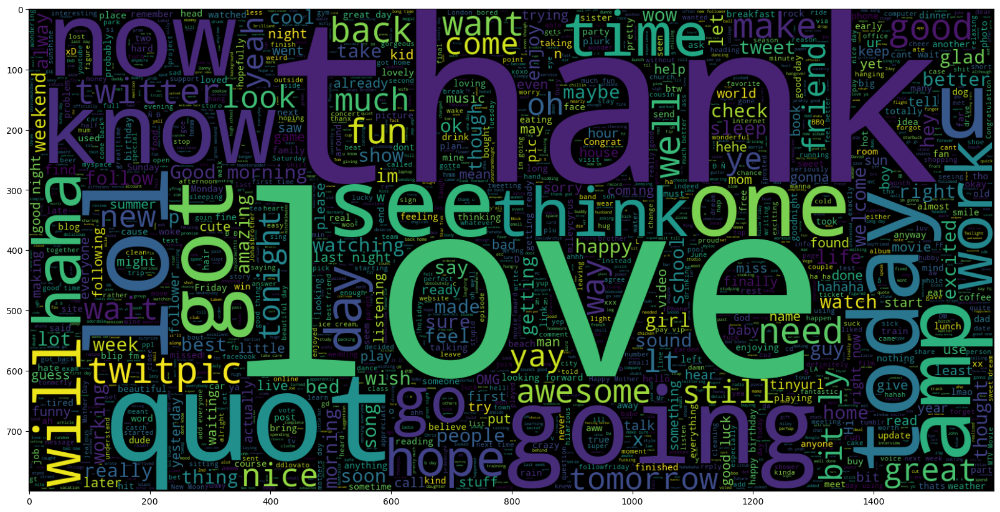

In [11]:
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(df[df["targets"] == 'Positive'].text))
plt.imshow(wc , interpolation = 'bilinear')

### Negative words

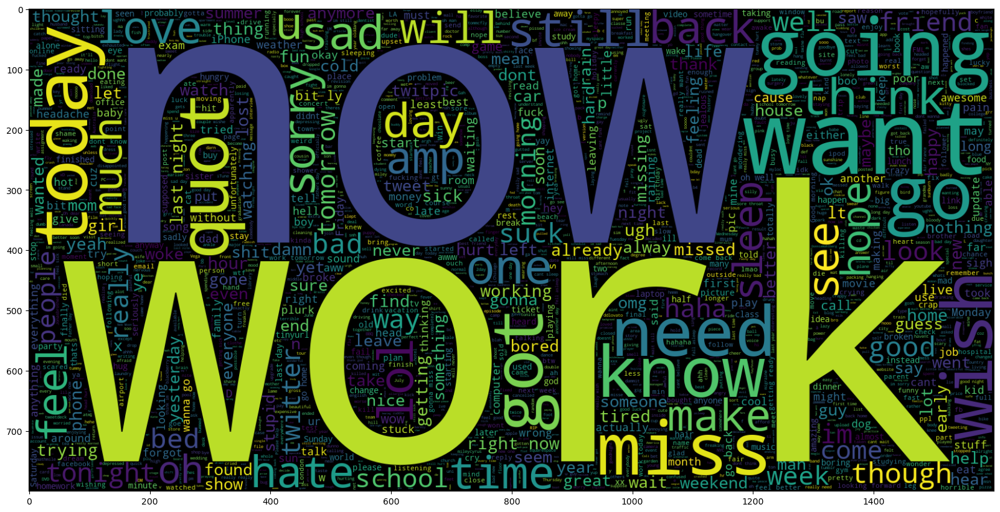

In [12]:
plt.figure(figsize = (20,20)) 
wc = WordCloud(max_words = 2000 , width = 1600 , height = 800).generate(" ".join(df[df["targets"] == 'Negative'].text))
plt.imshow(wc , interpolation = 'bilinear')